This is an ipynb file for the scientific study of forest damage-bark beetle detection using remote sensing in Latvia - 
This file was used to mask forest clearings in an ortophoto of the study area

In [2]:
import rasterio #https://github.com/rasterio/rasterio
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import time
import cv2

In [3]:
def normalize(img):
    subtr = np.subtract(img, np.ones(img.shape, dtype="float32") * img.min())
    subtrmaxmin = np.subtract(np.ones(img.shape, dtype="float32") * img.max(), np.ones(img.shape, dtype="float32") * img.min())
    normalized = np.divide(subtr, subtrmaxmin) * 254
    print("Max: ", normalized.max())
    print("Min: ", normalized.min())
    return normalized

In [4]:
img_path = "D:/Projekti/ZPD\QGIS/LGIA data/3334-42_3 roi/" + "lasgrid3.tif"
orto_path = "D:/Projekti/ZPD\QGIS/LGIA data/3334-42_3 roi/" + "VIS_clipped.tif"
_img = rasterio.open(img_path)
img = _img.read(1)

_orto = rasterio.open(orto_path)
orto = _orto.read()
orto = np.moveaxis(orto, 0, 2) #tranfsorms into wanted shape

In [5]:
plt.rcParams['figure.dpi'] = 150

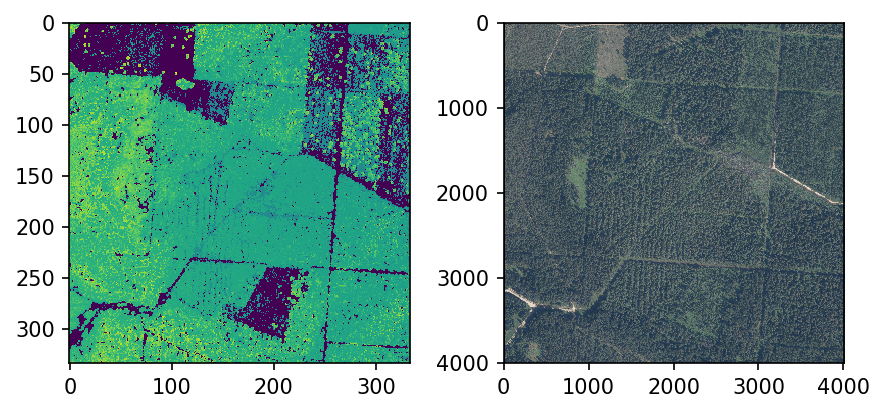

In [6]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(img)
subplot[1].imshow(orto)
plt.tight_layout()

In [7]:
#info
print("Shape: ", img.shape)
print("Max: ", img.max())
print("Min: ", img.min())

Shape:  (334, 334)
Max:  59.98
Min:  0.0


### Median blur:
https://docs.opencv.org/4.x/d4/d13/tutorial_py_filtering.html
Highly effective against pepper noise

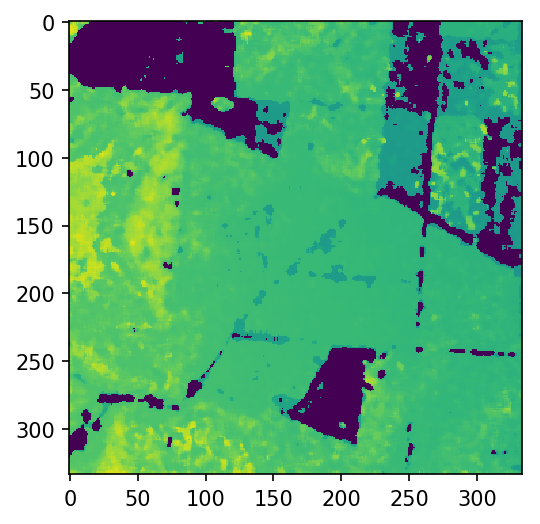

In [8]:
median = cv2.medianBlur(img,5)
plt.imshow(median)

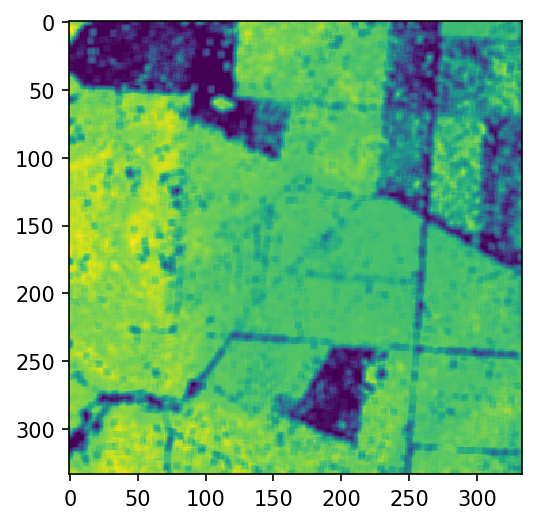

In [9]:
#The following are a series of tests for the best clearing mask creation
blurred_img = cv2.blur(img,ksize=(5,5))
plt.imshow(blurred_img)

### Opening:

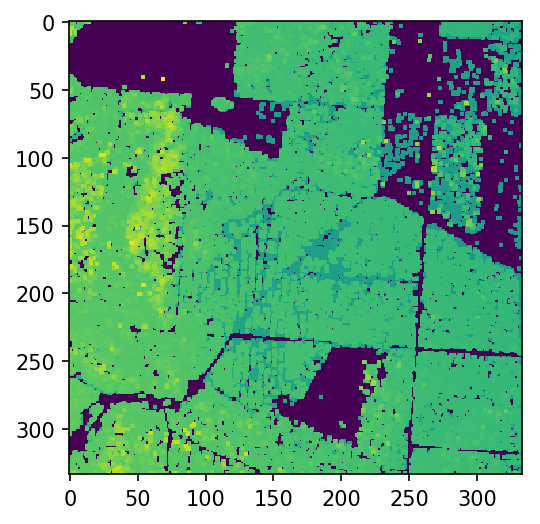

In [10]:
kernel = np.ones((3,3),np.uint8)
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
plt.imshow(opening)

Max:  254.0
Min:  0.0


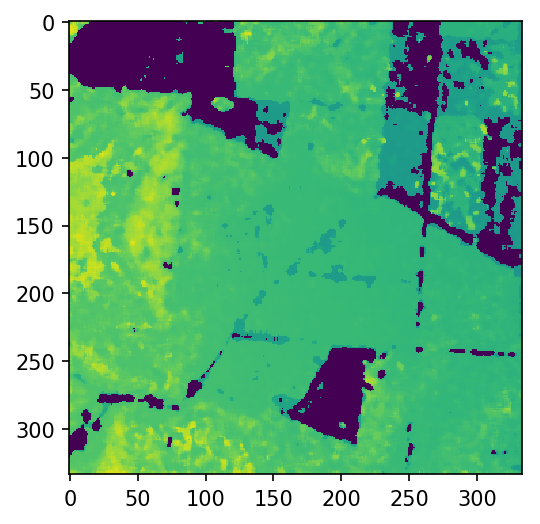

In [11]:
norm = normalize(img)
median = cv2.medianBlur(norm,5)
plt.imshow(median)

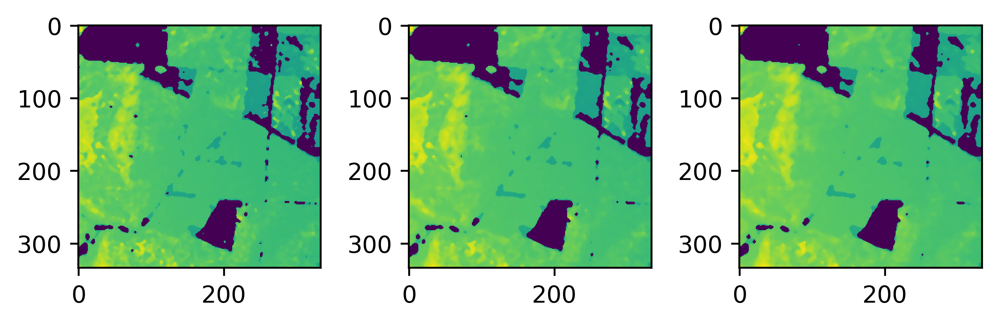

In [12]:
plt.rcParams['figure.dpi'] = 500

med2 = cv2.medianBlur(median,5)
med3 = cv2.medianBlur(med2,5)
med4 = cv2.medianBlur(med3,5)

fig, subplot = plt.subplots(nrows=1, ncols=3)
subplot[0].imshow(med2)
subplot[1].imshow(med3)
subplot[2].imshow(med4)
plt.tight_layout()

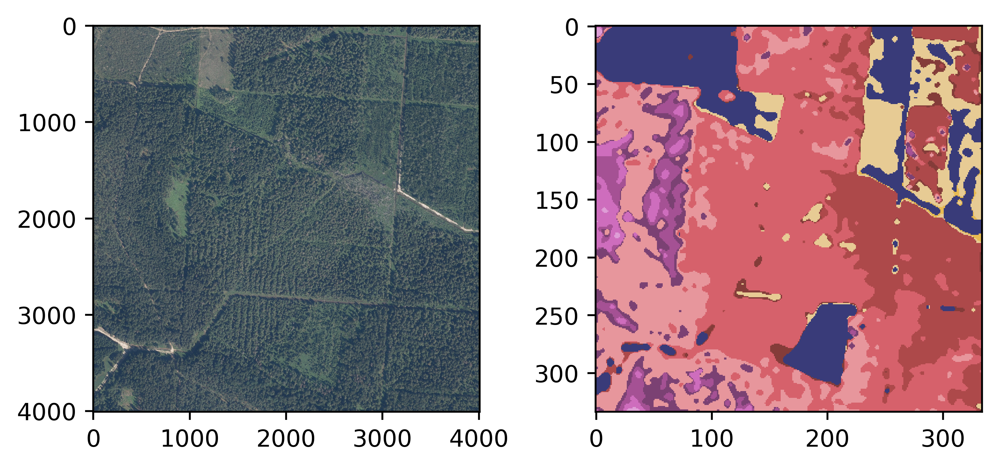

In [17]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(orto)
subplot[1].imshow(med3, cmap="tab20b")
plt.tight_layout()

In [18]:
ret, mask = cv2.threshold(med3, 135, 255, cv2.THRESH_BINARY)

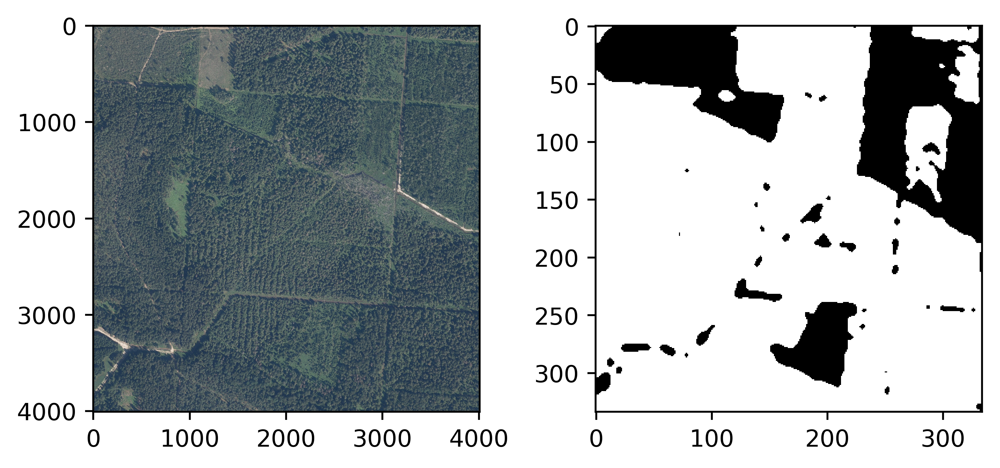

In [19]:
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(orto)
subplot[1].imshow(mask, cmap="gray")
plt.tight_layout()

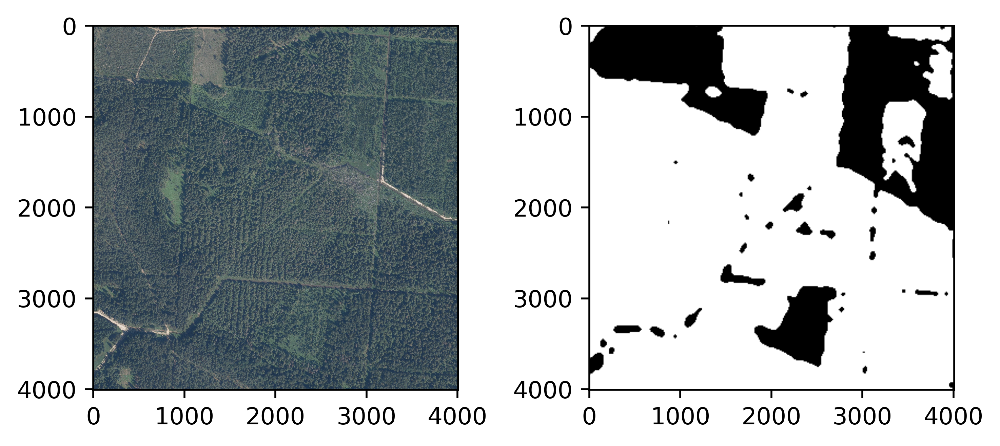

In [20]:
resized_mask = cv2.resize(mask, (orto.shape[0], orto.shape[1]))
fig, subplot = plt.subplots(nrows=1, ncols=2)
subplot[0].imshow(orto)
subplot[1].imshow(resized_mask, cmap="gray")
plt.tight_layout()

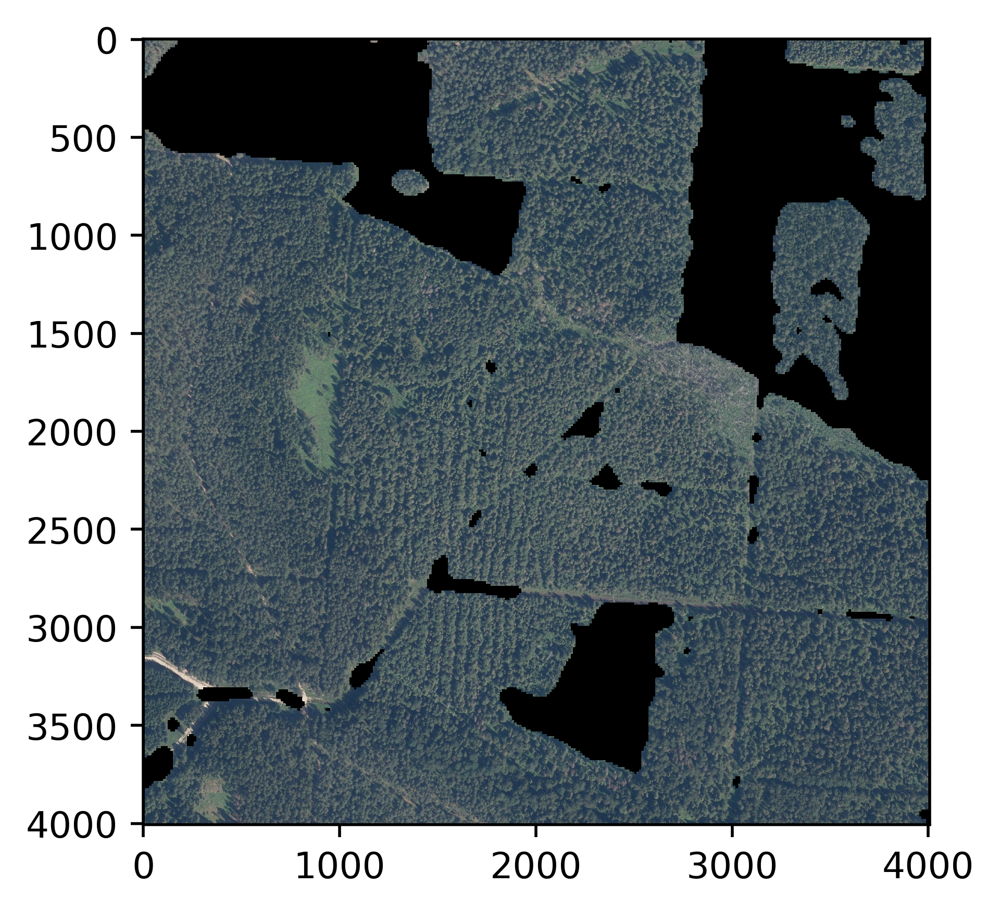

In [21]:
masked = orto.copy()
masked[resized_mask<1] = 0
plt.imshow(masked)

### Saving

In [22]:
from osgeo import gdal
filepath = "D:/Projekti/ZPD\QGIS/LGIA data/3334-42_3 roi/" + "VIS_clipped.tif"
ds = gdal.Open(filepath)
gt = ds.GetGeoTransform()
proj = ds.GetProjection()
print(gt, "\n", proj)

(529998.0, 0.25, 0.0, 294000.0, 0.0, -0.25) 
 PROJCS["LKS92 / Latvia TM",GEOGCS["LKS92",DATUM["Latvia_1992",SPHEROID["GRS 1980",6378137,298.257222101,AUTHORITY["EPSG","7019"]],TOWGS84[0,0,0,0,0,0,0],AUTHORITY["EPSG","6661"]],PRIMEM["Greenwich",0,AUTHORITY["EPSG","8901"]],UNIT["degree",0.0174532925199433,AUTHORITY["EPSG","9122"]],AUTHORITY["EPSG","4661"]],PROJECTION["Transverse_Mercator"],PARAMETER["latitude_of_origin",0],PARAMETER["central_meridian",24],PARAMETER["scale_factor",0.9996],PARAMETER["false_easting",500000],PARAMETER["false_northing",-6000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AUTHORITY["EPSG","3059"]]


In [23]:
driver = gdal.GetDriverByName("GTiff")
driver.Register()

2

In [24]:
outds = driver.Create("lasmask.tif", xsize = resized_mask.shape[1],
                      ysize = resized_mask.shape[0], bands = 1, 
                      eType = gdal.GDT_Int16)
outds.SetGeoTransform(gt)
outds.SetProjection(proj)

0

In [25]:
outband1 = outds.GetRasterBand(1)
outband1.WriteArray(resized_mask)
outband1.SetNoDataValue(np.nan)
outband1.FlushCache()
outband1 = None
outds = None

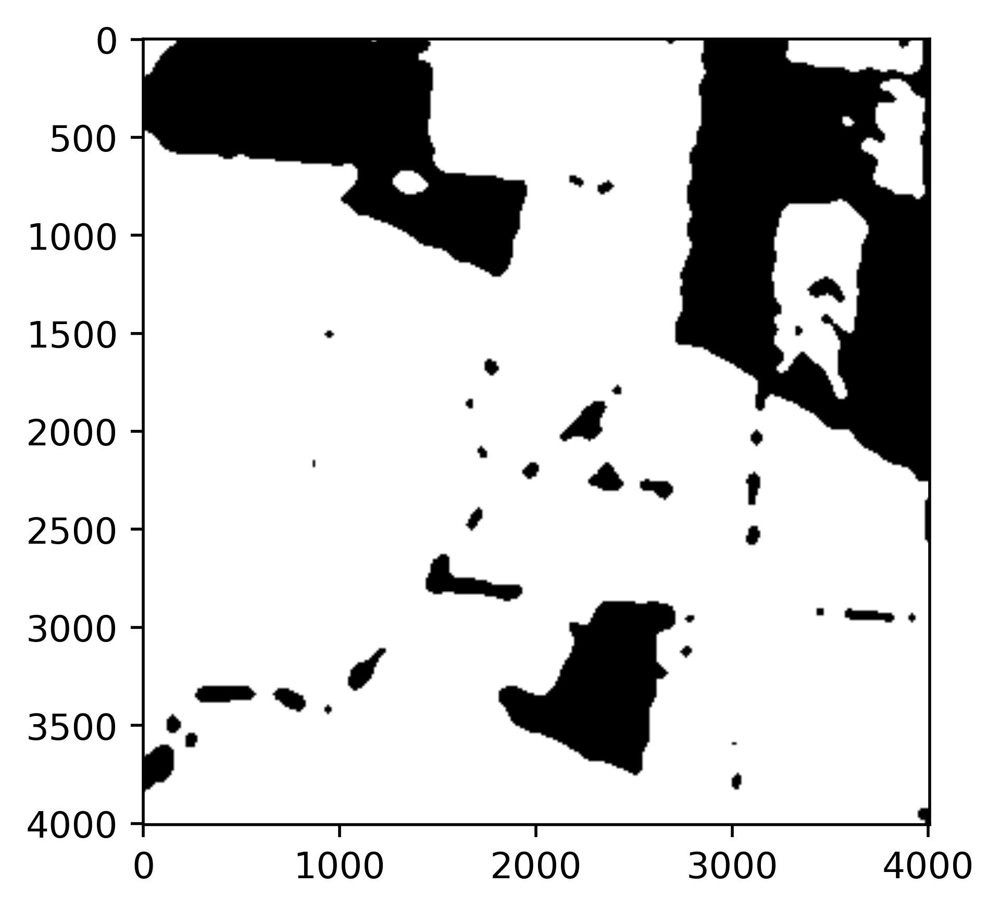

In [26]:
'''
Test whether successful
'''
tif = rasterio.open("lasmask.tif")
mask68_tif = tif.read(1)
plt.imshow(mask68_tif, cmap = "gray")